In [1]:
import numpy as np
import cv2
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import glob
%matplotlib inline

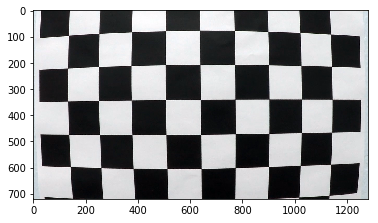

In [2]:
# Take a look at one image
img1 = cv2.imread('./camera_cal/calibration1.jpg')
plt.imshow(img1)

(1280, 720)
(720, 1280)


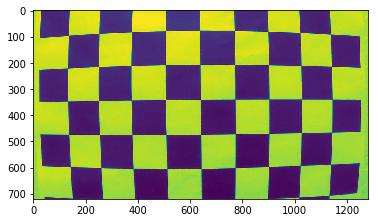

In [3]:
# Convert image to grayscale
gray_img1 = cv2.cvtColor(img1, cv2.COLOR_BGR2GRAY)
plt.imshow(gray_img1)

print(gray_img1.shape[::-1])
print((gray_img1.shape[0], gray_img1.shape[1]))

In [4]:
# Read in calibration images
cal_images = glob.glob('./camera_cal/calibration*.jpg')

In [5]:
# Objects to store object points and image points from all the images

objpoints = []
imgpoints = []

# Prepare object points like (0,0,0), (1,0,0), (2,0,0) ....,(8,5,0) 
# unlike in lesson video, calibration image above has 9x6 squares
nx = 9
ny = 6
objp = np.zeros((ny * nx, 3), np.float32)
objp[:, :2] = np.mgrid[0:nx, 0:ny].T.reshape(-1,2)  #x, y coordinated

for fname in cal_images:
    # Read in each image
    img = mpimg.imread(fname)
    
    # Convert image to grayscale
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

    # Find chessboard corners
    ret, corners = cv2.findChessboardCorners(gray, (nx,ny),None)

    # If corners are found, add objects points, image points
    if ret == True:
        imgpoints.append(corners)
        objpoints.append(objp)
    
        # draw and display corners
        img = cv2.drawChessboardCorners(img, (nx,ny), corners, ret)
        #plt.imshow(img)
    


In [6]:
# Calibrate camera
global mtx
global dist

ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints, (img1.shape[1], img1.shape[0]), None, None)

# Now try undistort img1 above
undist = cv2.undistort(img1, mtx, dist, None, mtx)

(720, 1280)


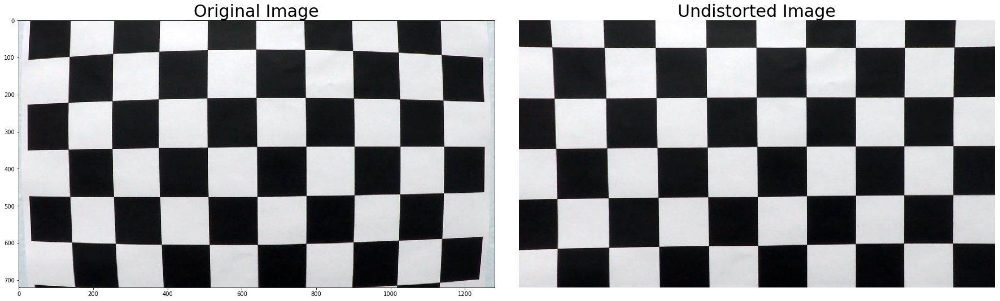

In [7]:
figure, axes = plt.subplots(1,2, figsize=(24, 9))
figure.tight_layout()

#axes[0].set_axis_off()
axes[0].imshow(img1)
axes[0].set_title('Original Image', fontsize=30)

axes[1].set_axis_off()
axes[1].imshow(undist)
axes[1].set_title('Undistorted Image', fontsize=30)
plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

cv2.imwrite('output_images/undistorted.png', undist)

print(undist.shape[:2])

In [8]:
# All constants in one place
nx = 9
ny = 6


# Area or region of interest
area_of_interest = np.array([[(220, 720),(550, 464),(730, 464),(1210, 720)]])
# Choose the number of sliding windows
nwindows = 9
# Set the width of the windows +/- margin
margin = 80
# Set minimum number of pixels found to recenter window
minpix = 40
# Define conversions in x and y from pixels space to meters
ym_per_pix = 30/720 # meters per pixel in y dimension
xm_per_pix = 3.7/700 # meters per pixel in x dimension
# Img_size
#img_size = (720, 1280)
#ploty = np.int32(np.linspace(0, img_size[0]-1, img_size[0]))

In [9]:
def undistort(img, mtx, dist):
    #imgin = cv2.imread(img)
    undistorted = cv2.undistort(img, mtx, dist, None, mtx)   # using mtx and dist from calibration above
    return undistorted
    

In [10]:
# Stdlib imports
from io import BytesIO

# Third-party libraries
from IPython.display import Image
from ipywidgets import interact, interactive, fixed
import matplotlib as mpl
from skimage import data, filters, io, img_as_float
import numpy as np

True

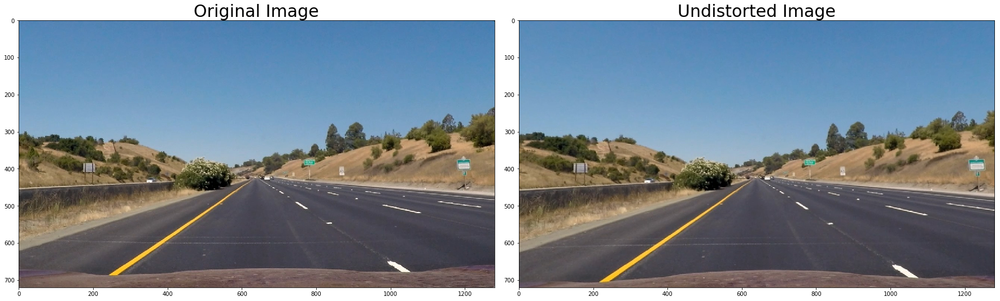

In [11]:
# Test on one image
test_img = cv2.imread('./test_images/straight_lines1.jpg')

undistorted = undistort(test_img,mtx,dist)
#undistorted = cv2.undistort(test_img, mtx, dist, None, mtx)

figure, axes = plt.subplots(1,2, figsize=(24, 9))
figure.tight_layout()

#axes[0].set_axis_off()
axes[0].imshow(cv2.cvtColor(test_img, cv2.COLOR_BGR2RGB))
axes[0].set_title('Original Image', fontsize=30)

#axes[1].set_axis_off()
axes[1].imshow(cv2.cvtColor(undistorted, cv2.COLOR_BGR2RGB))
axes[1].set_title('Undistorted Image', fontsize=30)
plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

cv2.imwrite('undistorted_test2.jpg', undistorted)



In [12]:
# Helper functions from Finding Lane Lines project

import math

def grayscale(img):
    """Applies the Grayscale transform
    This will return an image with only one color channel
    but NOTE: to see the returned image as grayscale
    (assuming your grayscaled image is called 'gray')
    you should call plt.imshow(gray, cmap='gray')"""
    return cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    # Or use BGR2GRAY if you read an image with cv2.imread()
    # return cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    
def gaussian_blur(img, kernel_size):
    """Applies a Gaussian Noise kernel"""
    return cv2.GaussianBlur(img, (kernel_size, kernel_size), 0)
    
def canny(img, low_threshold, high_threshold):
    """Applies the Canny transform"""
    return cv2.Canny(img, low_threshold, high_threshold)

def draw_lines(img, lines, color=[255, 0, 0], thickness=5):
    """
    NOTE: this is the function you might want to use as a starting point once you want to 
    average/extrapolate the line segments you detect to map out the full
    extent of the lane (going from the result shown in raw-lines-example.mp4
    to that shown in P1_example.mp4).  
    
    Think about things like separating line segments by their 
    slope ((y2-y1)/(x2-x1)) to decide which segments are part of the left
    line vs. the right line.  Then, you can average the position of each of 
    the lines and extrapolate to the top and bottom of the lane.
    
    This function draws `lines` with `color` and `thickness`.    
    Lines are drawn on the image inplace (mutates the image).
    If you want to make the lines semi-transparent, think about combining
    this function with the weighted_img() function below
    """

    for line in lines:
        for x1,y1,x2,y2 in line:
            cv2.line(img, (x1, y1), (x2, y2), color, thickness)

def hough_lines(img, rho, theta, threshold, min_line_len, max_line_gap):
    """
    `img` should be the output of a Canny transform.
        
    Returns an image with hough lines drawn.
    """
    lines = cv2.HoughLinesP(img, rho, theta, threshold, np.array([]), minLineLength=min_line_len, maxLineGap=max_line_gap)
    line_img = np.zeros((img.shape[0], img.shape[1], 3), dtype=np.uint8)
    draw_lines(line_img, lines)
    return line_img

def weighted_img(img, initial_img, α=0.8, β=1., γ=0.):
    """
    `img` is the output of the hough_lines(), An image with lines drawn on it.
    Should be a blank image (all black) with lines drawn on it.
    
    `initial_img` should be the image before any processing.
    
    The result image is computed as follows:
    
    initial_img * α + img * β + γ
    NOTE: initial_img and img must be the same shape!
    """
    return cv2.addWeighted(initial_img, α, img, β, γ)

def region_of_interest(img, vertices):
    """
    Applies an image mask.
    
    Only keeps the region of the image defined by the polygon
    formed from `vertices`. The rest of the image is set to black.
    """
    #defining a blank mask to start with
    mask = np.zeros_like(img)   
    
    #defining a 3 channel or 1 channel color to fill the mask with depending on the input image
    if len(img.shape) > 2:
        channel_count = img.shape[2]  # i.e. 3 or 4 depending on your image
        ignore_mask_color = (255,) * channel_count
    else:
        ignore_mask_color = 255
        
    #filling pixels inside the polygon defined by "vertices" with the fill color    
    cv2.fillPoly(mask, vertices, ignore_mask_color)
    
    #returning the image only where mask pixels are nonzero
    masked_image = cv2.bitwise_and(img, mask)
    return masked_image


In [13]:
# Source and destination for perspective transform
global src
global dst

src_bottom_left = [220, 720]
src_bottom_right = [1110, 720]
src_top_left = [570, 470]
src_top_right = [722, 470]
src = np.float32([src_bottom_left,src_bottom_right,src_top_right,src_top_left])

dst_bottom_left = [320, 720]
dst_bottom_right = [920, 720]
dst_top_left = [320, 1]
dst_top_right = [920, 1]
dst = np.float32([dst_bottom_left,dst_bottom_right,dst_top_right,dst_top_left]) 



In [14]:
def transform_perspective(img, src, dst):
    #src = np.float32([src_bottom_left,src_bottom_right,src_top_right,src_top_left])
    
    #dst = np.float32([dst_bottom_left,dst_bottom_right,dst_top_right,dst_top_left]) 
    
    # Grab the image shape
    img_size = (img.shape[1], img.shape[0])

    # Given src and dst points, calculate the perspective transform matrix
    M = cv2.getPerspectiveTransform(src, dst)

    # Warp the image using OpenCV warpPerspective()
    transformed = cv2.warpPerspective(img, M, img_size)

    # Return the resulting image and matrix
    return transformed

True

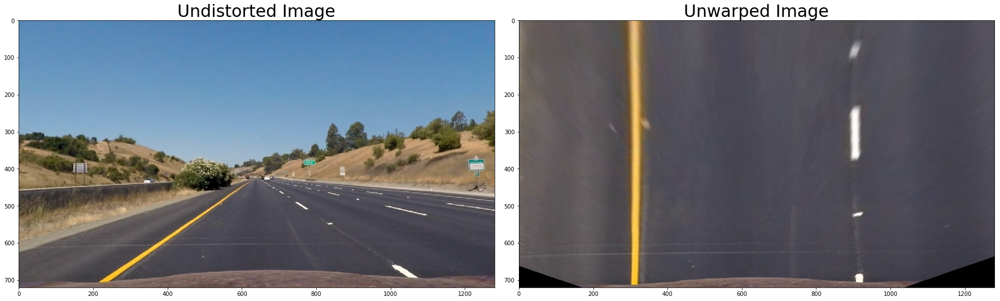

In [15]:
import numpy as np
import cv2
import matplotlib.pyplot as plt

# Test unwarp 

unwarped = transform_perspective(undistorted, src, dst)


figure, axes = plt.subplots(1,2, figsize=(24, 9))
figure.tight_layout()

#axes[0].set_axis_off()
axes[0].imshow(cv2.cvtColor(undistorted, cv2.COLOR_BGR2RGB))
axes[0].set_title('Undistorted Image', fontsize=30)

#axes[1].set_axis_off()
axes[1].imshow(cv2.cvtColor(unwarped, cv2.COLOR_BGR2RGB))
axes[1].set_title('Unwarped Image', fontsize=30)
plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

cv2.imwrite('Unwarped_or_transformed_test2.jpg', unwarped)

In [16]:
def blur_gray(img, kernel_size):
    #gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    gray = grayscale(img)
    # Define a kernel size and apply Gaussian smoothing
    kernel_size = 5
    blur_gray = gaussian_blur(gray, kernel_size)
    return blur_gray

In [17]:
# Define a function that takes an image, gradient orientation,
# and threshold min / max values.
def abs_sobel_thresh(img, orient='x', thresh_min=0, thresh_max=255):
    
    # Apply x or y gradient with the OpenCV Sobel() function
    # and take the absolute value
    if orient == 'x':
        abs_sobel = np.absolute(cv2.Sobel(img, cv2.CV_64F, 1, 0))
    if orient == 'y':
        abs_sobel = np.absolute(cv2.Sobel(img, cv2.CV_64F, 0, 1))
    # Rescale back to 8 bit integer
    scaled_sobel = np.uint8(255*abs_sobel/np.max(abs_sobel))
    # Create a copy and apply the threshold
    binary_output = np.zeros_like(scaled_sobel)
    # Here I'm using inclusive (>=, <=) thresholds, but exclusive is ok too
    binary_output[(scaled_sobel >= thresh_min) & (scaled_sobel <= thresh_max)] = 1

    # Return the result
    return binary_output



In [18]:
# Define a function to return the magnitude of the gradient
# for a given sobel kernel size and threshold values
def mag_thresh(img, sobel_kernel=3, thresh_min=0, thresh_max=255):
    # Take both Sobel x and y gradients
    sobelx = cv2.Sobel(img, cv2.CV_64F, 1, 0, ksize=sobel_kernel)
    sobely = cv2.Sobel(img, cv2.CV_64F, 0, 1, ksize=sobel_kernel)
    # Calculate the gradient magnitude
    gradmag = np.sqrt(sobelx**2 + sobely**2)
    # Rescale to 8 bit
    scale_factor = np.max(gradmag)/255 
    gradmag = (gradmag/scale_factor).astype(np.uint8) 
    # Create a binary image of ones where threshold is met, zeros otherwise
    binary_output = np.zeros_like(gradmag)
    binary_output[(gradmag >= thresh_min) & (gradmag <= thresh_max)] = 1

    # Return the binary image
    return binary_output

In [19]:
print(np.pi/2)

1.5707963267948966


In [20]:
# Define a function to threshold an image for a given range and Sobel kernel
def dir_threshold(img, sobel_kernel=3, dir_thresh_min=0, dir_thresh_max=1.5707963267948966):
    # Calculate the x and y gradients
    sobelx = cv2.Sobel(img, cv2.CV_64F, 1, 0, ksize=sobel_kernel)
    sobely = cv2.Sobel(img, cv2.CV_64F, 0, 1, ksize=sobel_kernel)
    # Take the absolute value of the gradient direction, 
    # apply a threshold, and create a binary image result
    absgraddir = np.arctan2(np.absolute(sobely), np.absolute(sobelx))
    binary_output =  np.zeros_like(absgraddir)
    binary_output[(absgraddir >= dir_thresh_min) & (absgraddir <= dir_thresh_max)] = 1

    # Return the binary image
    return binary_output

In [21]:
#Red, green thresholds
def red_green_threshold(img, r_g_threshold=150):
    red = img[:,:,0]
    green = img[:,:,1]
    binary_out = np.zeros.like(red)
    binary_out[(red > r_g_threshold) & (green > r_g_threshold)] = 1
    return binary_out

In [22]:
# Color channel:  s
def s_channel_thresh(img, s_thresh_min=100, s_thresh_max=255):
    s_img = cv2.cvtColor(img, cv2.COLOR_RGB2HLS)
    s_channel = s_img[:,:,2]
    binary_out = np.zeros.like(s_channel)
    binary_out[(s_channel >= s_thresh_min) & (s_channel <= s_thresh_max)] = 1
    return binary_out

In [23]:
# Color channel:  l
def l_channel_thresh(img, l_thresh_min=120, l_thresh_max=255):
    l_img = cv2.cvtColor(img, cv2.COLOR_RGB2LUV)
    l_channel = l_img[:,:,2]
    binary_out = np.zeros.like(l_channel)
    binary_out[(l_channel >= l_thresh_min) & (l_channel <= l_thresh_max)] = 1
    return binary_out

In [24]:
def pipeline(img, kernel_size=5, low_thres=50, high_thres=150, thresh_min=0, \
                    thresh_max=255, sobel_kernel=3, \
                   dir_thresh_min=0, dir_thresh_max=1.5708, \
                   s_thresh_min = 80, s_thresh_max = 255):
    #imgin = cv2.imread(img)
    
    # Undistort
    undistorted = undistort(img, mtx, dist)
    
    # Unwarp to get top-down or birdseye view
    unwarped = transform_perspective(undistorted, src, dst)
    
    # Apply blur gray
    #gray = blur_gray(unwarped, kernel_size)
    
    # Apply canny
    #cannied = canny(gray, 50, 150)
    
    # Apply each of the thresholding functions
    gradx = abs_sobel_thresh(unwarped, 'x',  thresh_min, thresh_max)
    grady = abs_sobel_thresh(unwarped, 'y',  thresh_min, thresh_max)
    #gradx = abs_sobel_thresh(gray, 'x',  thresh_min, thresh_max)
    #grady = abs_sobel_thresh(gray, 'y',  thresh_min, thresh_max)
    
    # Apply mag_thresh
    mag_thresh_img = mag_thresh(unwarped, sobel_kernel, thresh_min, thresh_max)
    #mag_thresh_img = mag_thresh(gray, sobel_kernel, thresh_min, thresh_max)
    
    # Apply direction_thresh
    dir_thresh_img = dir_threshold(unwarped, sobel_kernel, dir_thresh_min, dir_thresh_max)
    #dir_thresh_img = dir_threshold(gray, sobel_kernel, dir_thresh_min, dir_thresh_max)
    
    # Combine
    combined = np.zeros_like(dir_thresh_img)
    combined[((gradx == 1) & (grady == 1)) | ((mag_thresh_img == 1) & (dir_thresh_img == 1))] = 1
    
    # Apply s_channel_thresh
    hls_img = cv2.cvtColor(unwarped, cv2.COLOR_RGB2HLS)
    s_channel = hls_img[:,:,2]
    # Threshold color channel
    s_thresh_min = s_thresh_min
    s_thresh_max = s_thresh_max
    
    # Combine
    out_binary = np.zeros_like(combined)
    out_binary[(s_channel >= s_thresh_min) & (s_channel <= s_thresh_max)] = 1

    return out_binary

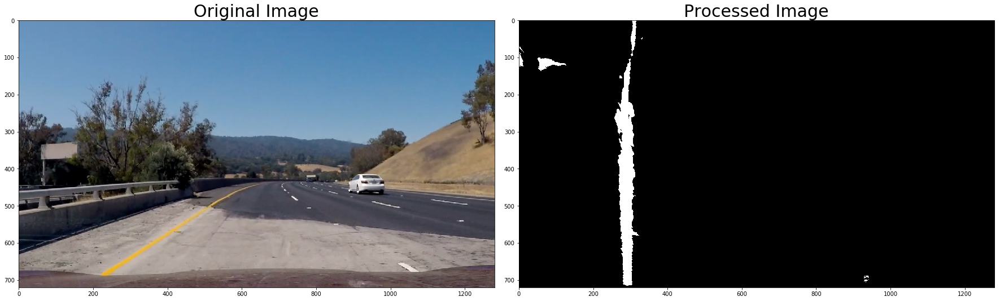

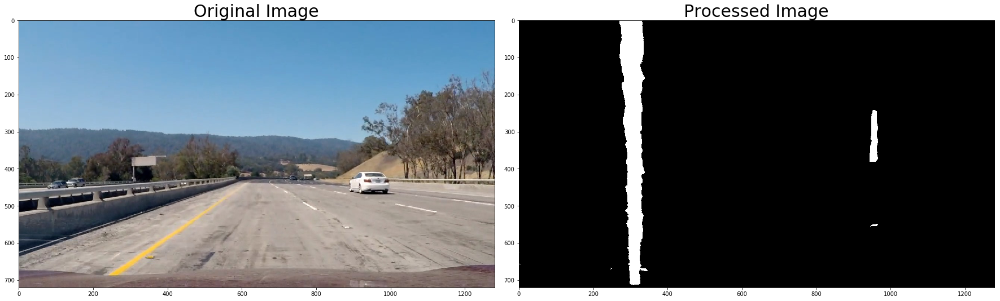

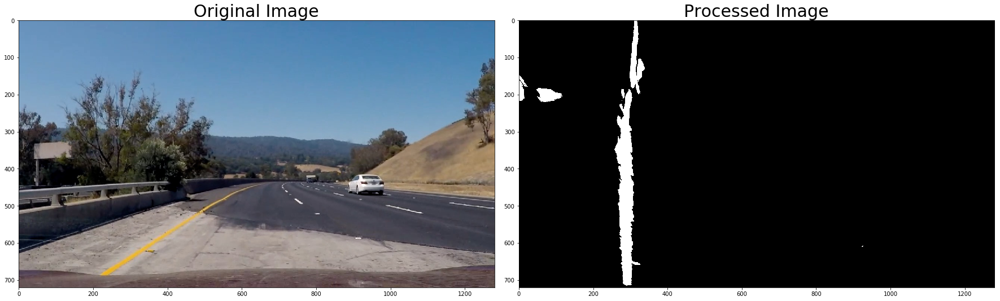

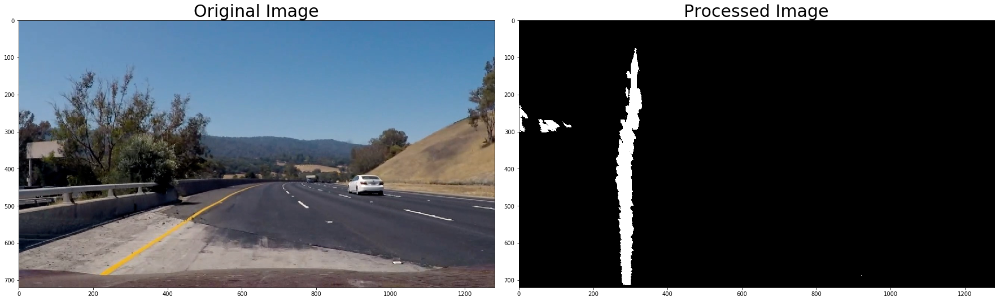

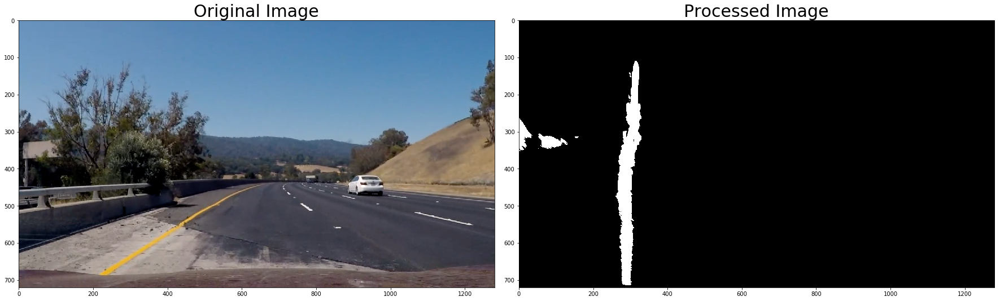

...

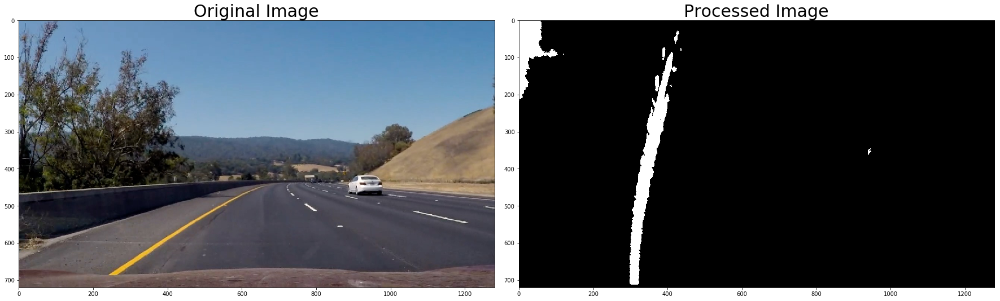

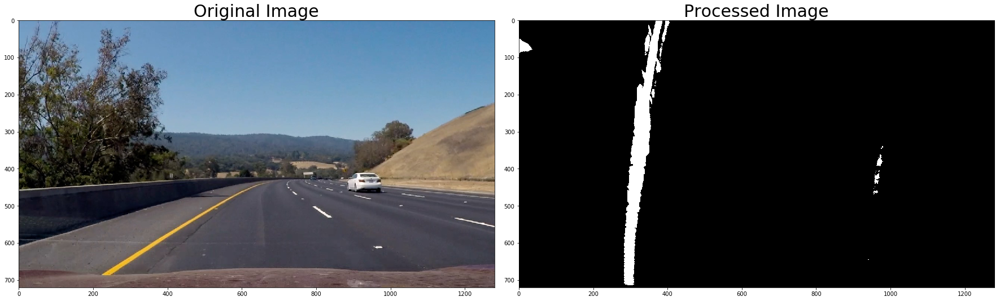

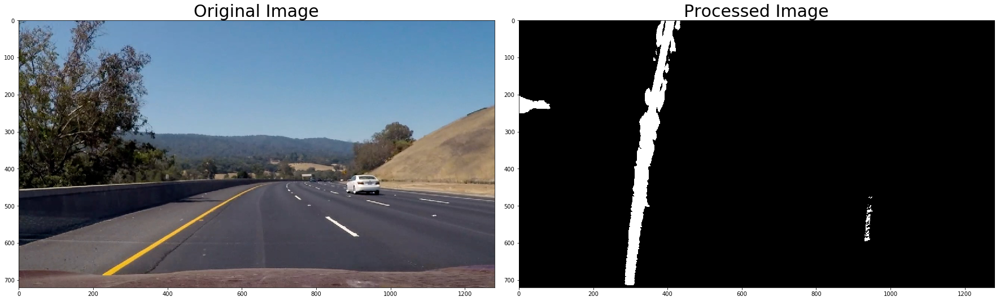

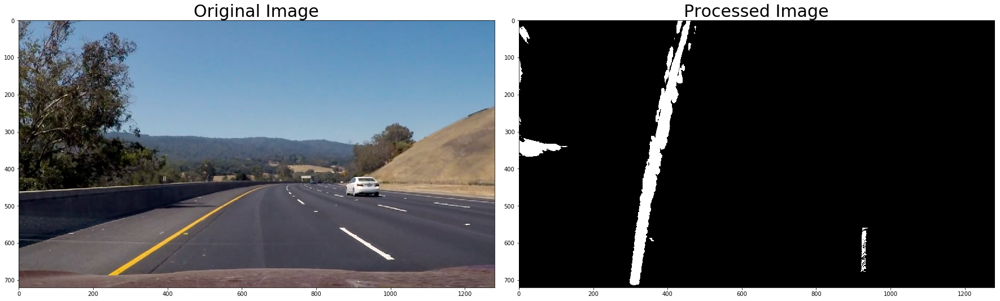

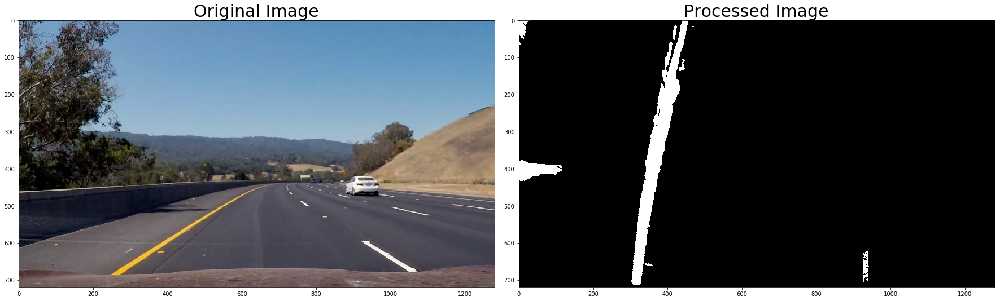

In [25]:
#Test and see if right lanes are detected
#test_images = glob.glob('./trouble_images/realbad*.jpg')
#test_images = glob.glob('./turn/turn2.jpg')
#test_images = glob.glob('./trouble_images/519_*.jpg')
test_images = glob.glob('./trouble_images/428_1*.jpg')
#test_images = glob.glob('./trouble_images/520_*.jpg')
for fname in test_images:
    test_img = cv2.imread(fname)
    out_img = pipeline(test_img)
    #print(out_img.shape)
    #out_img = pipeline_tryout3(test_img)
    
    figure, axes = plt.subplots(1,2, figsize=(24, 9))
    figure.tight_layout()

    #axes[0].set_axis_off()
    axes[0].imshow(cv2.cvtColor(test_img, cv2.COLOR_BGR2RGB))
    axes[0].set_title('Original Image', fontsize=30)
    
    axes[1].imshow(out_img,cmap='gray')
    axes[1].set_title('Processed Image', fontsize=30)
    
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

In [26]:
# Pipeline function
def pipeline_tryout3(img, \
                     s_thresh_min = 100, s_thresh_max = 255, \
                    b_thresh_min = 150,b_thresh_max = 200, \
                   l_thresh_min = 215, l_thresh_max = 255, \
                   ):
    #imgin = cv2.imread(img)
    
    # Undistort
    #undistorted = undistort(imgin, mtx, dist)
    undistorted = undistort(img, mtx, dist)
    
    # Unwarp to get top-down or birdseye view
    unwarped = transform_perspective(undistorted, src, dst)    
    
    # Apply s_channel_thresh
    hls_img = cv2.cvtColor(unwarped, cv2.COLOR_BGR2HLS)
    s_channel = hls_img[:,:,2]
    s_binary = np.zeros_like(s_channel)
    s_binary[(s_channel >= s_thresh_min) & (s_channel <= s_thresh_max)] = 1

    # Apply b_channel_thresh
    hls_img = cv2.cvtColor(unwarped, cv2.COLOR_BGR2Lab)
    b_channel = hls_img[:,:,2]
    b_binary = np.zeros_like(b_channel)
    b_binary[(b_channel >= b_thresh_min) & (b_channel <= b_thresh_max)] = 1
    
    # Apply l_channel_thresh
    hls_img = cv2.cvtColor(unwarped, cv2.COLOR_BGR2LUV)
    l_channel = hls_img[:,:,0]
    l_binary = np.zeros_like(l_channel)
    l_binary[(l_channel >= l_thresh_min) & (l_channel <= l_thresh_max)] = 1
    
    # Combine
    out_binary = np.zeros_like(s_binary)
    out_binary[(l_binary == 1) | (b_binary == 1)] = 1
    
    return out_binary

    

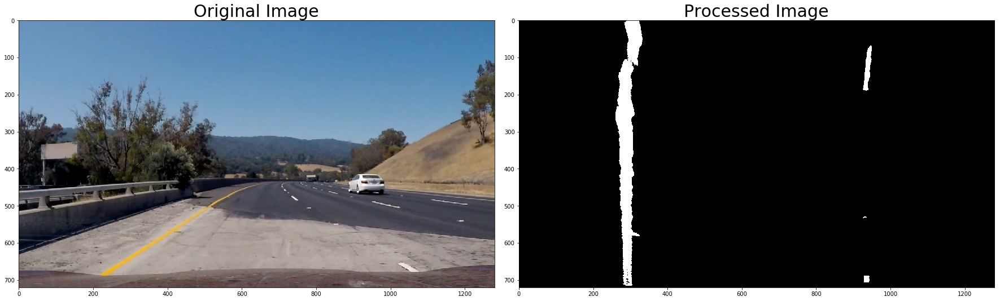

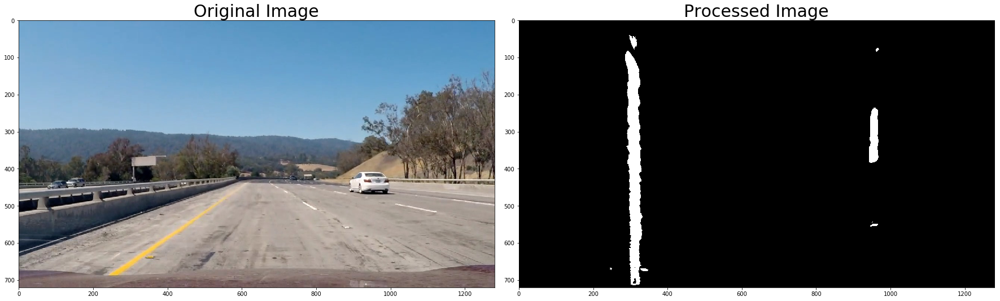

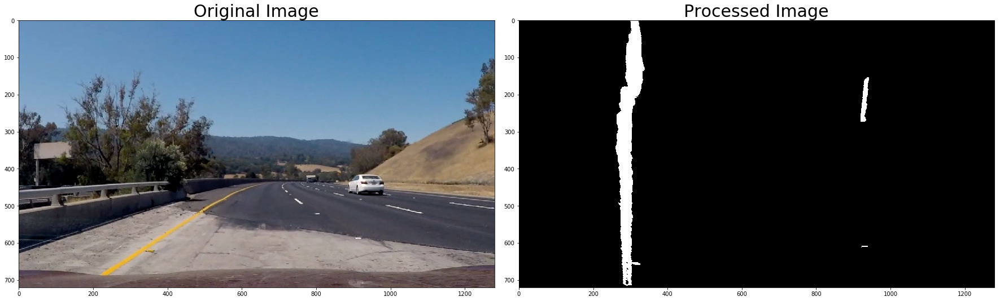

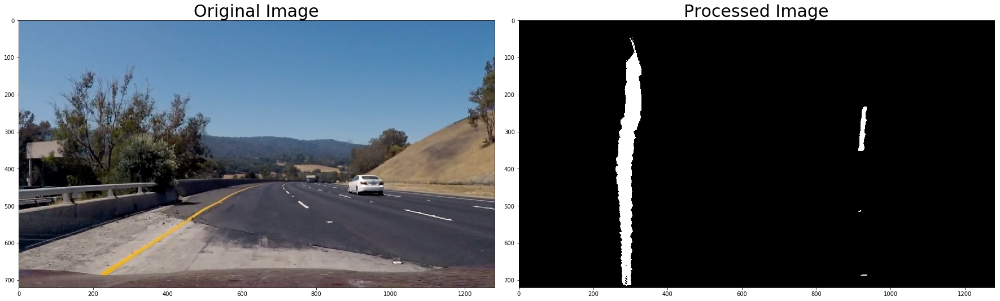

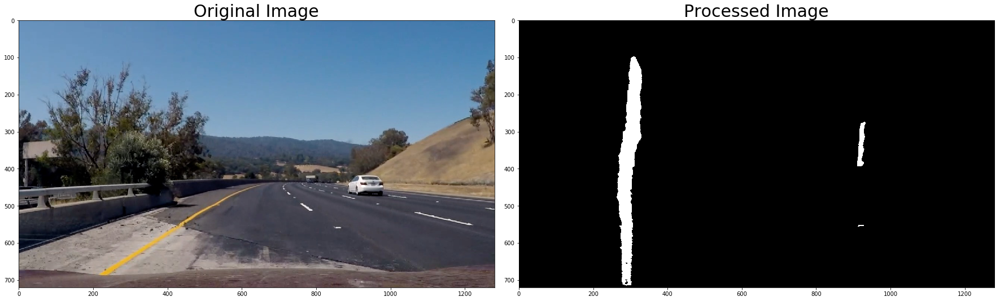

...

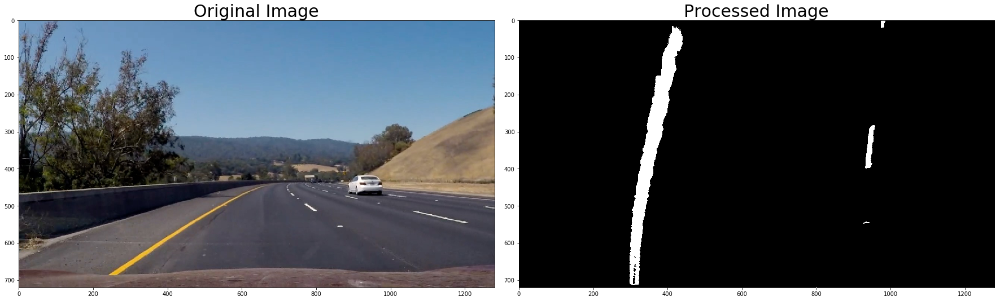

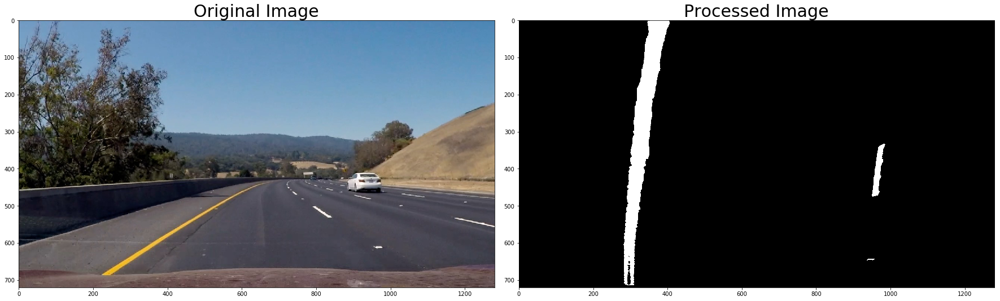

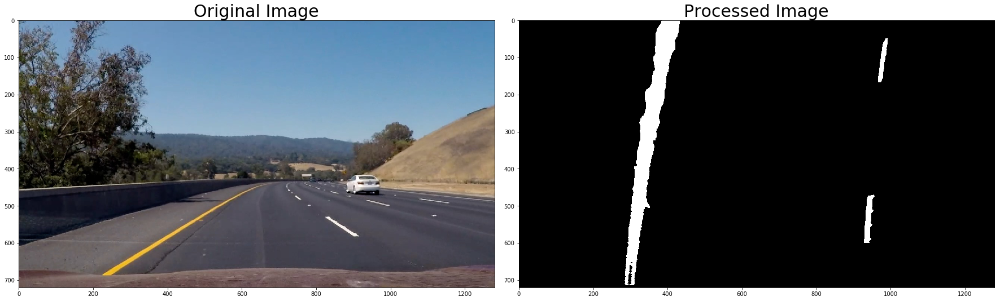

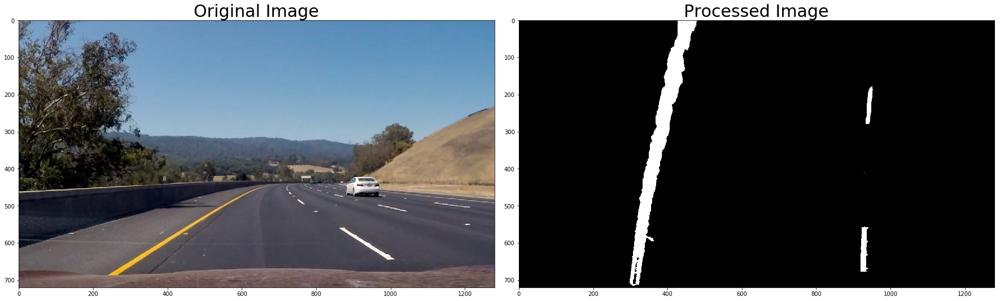

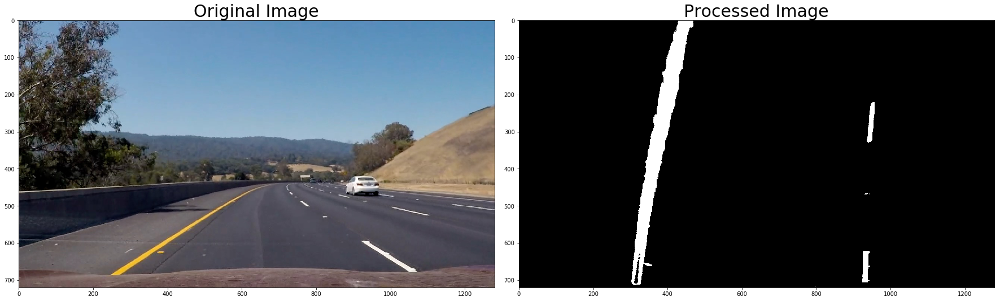

In [27]:
# Test pipeline on all test images
#test_images = glob.glob('./test_images/test*.jpg')
#test_images = glob.glob('./trouble_images/bad*.jpg')
#test_images = glob.glob('./right_turn/right_turn*.jpg')
#test_images = glob.glob('./trouble_images/428_*.jpg')
test_images = glob.glob('./trouble_images/428_1*.jpg')
for fname in test_images:
    test_img = cv2.imread(fname)
    out_img = pipeline_tryout3(test_img)
    #print(out_img.shape)
    #out_img = pipeline_tryout(test_img)
    
    figure, axes = plt.subplots(1,2, figsize=(24, 9))
    figure.tight_layout()

    #axes[0].set_axis_off()
    axes[0].imshow(cv2.cvtColor(test_img, cv2.COLOR_BGR2RGB))
    axes[0].set_title('Original Image', fontsize=30)
    
    axes[1].imshow(out_img,cmap='gray')
    axes[1].set_title('Processed Image', fontsize=30)
    
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

In [28]:
global print_diag
print_diag = False

In [29]:
def get_histogram(binary_warped, PIPE3):
    if PIPE3:
        histogram = np.sum(binary_warped[binary_warped.shape[0]//2:,:], axis=0)
    else:
        histogram = np.sum(binary_warped[binary_warped.shape[0]//2:,:,0], axis=0)
    
    #histogram = np.sum(binary_warped[binary_warped.shape[0]//2:,:], axis=0)
    
    return histogram

In [30]:

def sliding_windows(binary_warped, PIPE3, \
                    margin=40, minpix=30, \
                    nwindows=9):
    # Assuming you have created a warped binary image called "binary_warped"
    # Take a histogram of the bottom half of the image

    #histogram = np.sum(binary_warped[binary_warped.shape[0]//2:,:,0], axis=0)
    #histogram = np.sum(binary_warped[binary_warped.shape[0]//2:,:], axis=0)
    histogram = get_histogram(binary_warped, PIPE3)
    
    
    
    # Create an output image to draw on and  visualize the result
    #out_img = np.dstack((binary_warped, binary_warped, binary_warped))*255
    # Find the peak of the left and right halves of the histogram
    # These will be the starting point for the left and right lines
    midpoint = np.int(histogram.shape[0]//2)
    
    # Set the width of the windows +/- margin
    margin = margin
    # Set minimum number of pixels found to recenter window
    minpix = minpix
    # Create empty lists to receive left and right lane pixel indices
    left_lane_inds = []
    right_lane_inds = []
    # Windows
    slidwindows = []
    # Plot data
    plot_data = []
    
    # Choose the number of sliding windows
    nwindows = nwindows

    # Set height of windows
    window_height = np.int(binary_warped.shape[0]/nwindows)

    # Identify the x and y positions of all nonzero pixels in the image
    nonzero = binary_warped.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    
    leftx_base = np.argmax(histogram[:midpoint])
    rightx_base = np.argmax(histogram[midpoint:]) + midpoint
    
    #leftx_base = leftx_base
    #rightx_base = rightx_base

    
    #print('base pts:', leftx_base, rightx_base)
    
    # Current positions to be updated for each window
    leftx_current = leftx_base
    rightx_current = rightx_base

    
    # Step through the windows one by one
    for window in range(nwindows):
        # Identify window boundaries in x and y (and right and left)
        win_y_low = binary_warped.shape[0] - (window+1)*window_height
        win_y_high = binary_warped.shape[0] - window*window_height
        win_xleft_low = leftx_current - margin
        win_xleft_high = leftx_current + margin
        win_xright_low = rightx_current - margin
        win_xright_high = rightx_current + margin
        slidwindows.append((win_y_low, win_y_high, win_xleft_low, win_xleft_high, win_xright_low, win_xright_high))

        # Identify the nonzero pixels in x and y within the window
        good_left_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & (nonzerox >= win_xleft_low) & (nonzerox < win_xleft_high)).nonzero()[0]
        good_right_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & (nonzerox >= win_xright_low) & (nonzerox < win_xright_high)).nonzero()[0]
        
        
        # Append these indices to the lists
        left_lane_inds.append(good_left_inds)
        right_lane_inds.append(good_right_inds)

        # If you found > minpix pixels, recenter next window on their mean position
        if len(good_left_inds) > minpix:
            leftx_current = np.int(np.mean(nonzerox[good_left_inds]))
        if len(good_right_inds) > minpix:        
            rightx_current = np.int(np.mean(nonzerox[good_right_inds]))
    
    # Concatenate the arrays of indices
    left_lane_inds = np.concatenate((left_lane_inds))
    right_lane_inds = np.concatenate(right_lane_inds)

    # Extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds] 

    left_fit, right_fit = (None, None)
    left_fitx, right_fitx = (None, None)
    
    ploty = np.int32(np.linspace(0, binary_warped.shape[0]-1, binary_warped.shape[0]))
    #ploty = np.linspace(0, binary_warped.shape[0]-1, binary_warped.shape[0])

    # Fit a second order polynomial to each
    if len(leftx) != 0 and len(lefty) != 0:
        left_fit = np.polyfit(lefty, leftx, 2)
        left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]

    if len(rightx) != 0 and len(righty) != 0:
        right_fit = np.polyfit(righty, rightx, 2)
        right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
    
    if print_diag:
        print(left_fit)
        print(right_fit)
    
    # Plot data
    plot_data = (slidwindows, histogram)
    
    return left_fit, right_fit, left_fitx, right_fitx, left_lane_inds, right_lane_inds, plot_data

In [31]:
def skip_sliding_windows(binary_warped, left_best_fit, right_best_fit):
    nonzero = binary_warped.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    
    margin = 100
    
    #print('last_left_fit: ',last_left_fit)
    #print('last_right_fit: ',last_right_fit)
    
    new_left_lane_inds = ((nonzerox > (left_best_fit[0]*(nonzeroy**2) + left_best_fit[1]*nonzeroy + left_best_fit[2] - margin)) & (nonzerox < (left_best_fit[0]*(nonzeroy**2) + left_best_fit[1]*nonzeroy + left_best_fit[2] + margin))) 

    new_right_lane_inds = ((nonzerox > (right_best_fit[0]*(nonzeroy**2) + right_best_fit[1]*nonzeroy + right_best_fit[2] - margin)) & (nonzerox < (right_best_fit[0]*(nonzeroy**2) + right_best_fit[1]*nonzeroy + right_best_fit[2] + margin)))  

    #print('new_left_lane_inds: ',new_left_lane_inds)
    #print('new_right_lane_inds: ',new_right_lane_inds)
    
    # Again, extract left and right line pixel positions
    new_leftx = nonzerox[new_left_lane_inds]
    new_lefty = nonzeroy[new_left_lane_inds] 
    new_rightx = nonzerox[new_right_lane_inds]
    new_righty = nonzeroy[new_right_lane_inds]
    
    ploty = np.int32(np.linspace(0, binary_warped.shape[0]-1, binary_warped.shape[0]))
    # Fit a second order polynomial to each
    if(len(new_lefty) != 0):
        new_left_fit = np.polyfit(new_lefty, new_leftx, 2)
        new_left_fitx = new_left_fit[0]*ploty**2 + new_left_fit[1]*ploty + new_left_fit[2]
    else:
        new_left_fit = left_best_fit
    if(len(new_righty) != 0):
        new_right_fit = np.polyfit(new_righty, new_rightx, 2)
        new_right_fitx = new_right_fit[0]*ploty**2 + new_right_fit[1]*ploty + new_right_fit[2]
    else:
        new_right_fit = right_best_fit
    
    return new_left_fit, new_right_fit, new_left_fitx, new_right_fitx, new_left_lane_inds, new_right_lane_inds


In [32]:
# Need a class to hold characteristics of a line
class Line:

    def __init__(self):
       # was the line detected in the last iteration?
        self.detected = False

        # x values of the last n fits of the line
        self.recent_xfitted = []

        # maximum size of self.recent_xfitted
        self.max_recent_xfitted = 10

        # average x values of the fitted line over the last n iterations
        self.bestx = None

        # polynomial coefficients averaged over the last n iterations
        self.best_fit = None
        
        # flag to print diagnostics
        self.print_diag = False

        # last 10 recent fits
        self.past_fit = []
        
        # avg of last 10 fits
        self.avg_fit = []
        
        # lane indices
        self.lane_idx = []
        
        # radius of curvature of the line in some units
        self.radius_of_curvature = None

        # distance in meters of vehicle center from the line
        self.line_base_pos = None

        # difference in fit coefficients between last and new fits
        self.diffs = np.array([0, 0, 0], dtype='float')
        
        # diff too big
        self.diff_too_big = False

        # x values for detected line pixels
        self.allx = None

        # y values for detected line pixels
        self.ally = None

        # meters per pixel in y dimension
        self.meters_per_pixel_y = ym_per_pix

        # meters per pixel in x dimension
        self.meters_per_pixel_x = xm_per_pix
        
        # turn radius
        self.turn_rad = None
        
        # line/lane pipe3 flag
        #self.pipe3flag = None

In [33]:
def find_fitx(bin_img,line_fit):
    ploty = np.linspace(0, bin_img.shape[0]-1, bin_img.shape[0] )
    line_fitx = line_fit[0]*ploty**2 + line_fit[1]*ploty + line_fit[2]
    
    return line_fitx

In [34]:
def get_binary_warped(img, img_pipeline):
 
    bin_warp = img_pipeline(img)
    return bin_warp

In [35]:
def find_lines(img, img_pipeline, left_line, right_line, PIPE3):
    left_best_fit, right_best_fit = None, None
    pipe3flag = False
    if PIPE3:
        pipe3flag = True
    if left_line.print_diag or right_line.print_diag:
        print('img_pipeline: ', img_pipeline)
    bin_warp = get_binary_warped(img, img_pipeline)
    # sliding_wndows
    l_fit, r_fit, l_fitx, r_fitx, l_inds, r_inds, _ = sliding_windows(bin_warp, PIPE3,\
                    margin=40, minpix=30, \
                    nwindows=9)
        
    return bin_warp, l_fit, r_fit, l_fitx, r_fitx, l_inds, r_inds, pipe3flag

In [36]:
def find_left_lines(img, img_pipeline, PIPE3):
    left_best_fit = None
    pipe3flag = False
    if PIPE3:
        pipe3flag = True

    if print_diag:
        print('img_pipeline: ', img_pipeline)
    bin_warp = get_binary_warped(img, img_pipeline)
    # sliding_wndows
    l_fit, _, l_fitx, _, l_inds, _, _ = sliding_windows(bin_warp, PIPE3,\
                    margin=40, minpix=30, \
                    nwindows=9)
        
    return l_fit, l_fitx, l_inds, pipe3flag

In [37]:
def find_right_lines(img, img_pipeline, PIPE3):
    right_best_fit = None
    pipe3flag = PIPE3
    if PIPE3:
        pipe3flag = True

    if print_diag:
        print('img_pipeline: ', img_pipeline)
    bin_warp = get_binary_warped(img, img_pipeline)
    # sliding_wndows
    _, r_fit, _, r_fitx, _, r_inds, _ = sliding_windows(bin_warp, PIPE3,\
                    margin=40, minpix=30, \
                    nwindows=9)
        
    return r_fit, r_fitx, r_inds, pipe3flag

In [38]:
def is_diff_too_big(line,fit):
    #return line.diff_too_big = False
    
    if line.best_fit is not None and fit is not None:
        line.diffs = abs(fit - line.best_fit)
        if line.print_diag:
            print('line.diffs: ', line.diffs)    
        if (line.diffs[0] > 0.001 or \
            line.diffs[1] > 0.5 or \
            line.diffs[2] > 1000.):
                if line.print_diag:
                    print('line.diffs too big')
                line.diff_too_big = True
        else:
            line.diff_too_big = False
    else:
        line.diff_too_big = False
            
    return line.diff_too_big

In [42]:
import numpy as np
def sanity_check_fit(line,fit):
    #check_status = None

    if fit is not None:
        if line.print_diag:
            print('fit to check:', fit)
        # if we have a best fit, see how this new fit compares
        if line.best_fit is not None:
            if line.print_diag:
                print('line previous best_fit:', line.best_fit)            
            if is_diff_too_big(line,fit):
                line.detected = False
                check_status = True
                if line.print_diag:
                    print('Fit failed is_diff_too_big')
            else:       
                line.detected = True
                check_status = True
                if line.print_diag:
                    print('Fit passed is_diff_too_big')
                
        elif line.best_fit is None:
            #line.best_fit = fit
            #check_status = True
            if is_diff_too_big(line,fit):
                line.detected = False
                check_status = False
            else:
                line.best_fit = fit
                recommended_fit = fit
                check_status = True
                if line.print_diag:
                    print('Outer line.best_fit is new fit: ',fit)
                    print('Check-status: true')
            
    elif fit is None:
        line.detected = False
        if line.print_diag:
            print('elif fit is None')
        check_status = False
    #else:
    #    check_status = False
    
    if line.print_diag:
        if check_status:
            print('check_status-end: True')
        else:
            print('check_status-end: False')
            
    return check_status

In [41]:
def force_fit(line, avg_fit_keep=4):
    if len(line.past_fit) > avg_fit_keep:
                        line.past_fit = line.past_fit[1:]
        
    line.avg_fit = np.average(line.past_fit, axis=0)
    line.best_fit = line.avg_fit
    if line.print_diag:
        print('Done force fit')
    return line.best_fit 

In [43]:
def fit_lines(img, left_line, right_line, \
             l_fit, r_fit, l_fitx, r_fitx, l_inds, r_inds, isLeftFlag, PIPE3flag):
    
    pipe3flag = None
    
    if PIPE3flag == True:
        if isLeftFlag:
            bin_warp_l, alt_l_fit, _, alt_l_fitx, _, alt_l_inds, _, alt_l_pipeflag= find_lines(img, pipeline, \
                                                left_line, right_line, PIPE3=False)
        else:
            bin_warp_r, _, alt_r_fit, _, alt_r_fitx, _, alt_r_inds, alt_r_pipeflag = find_lines(img, pipeline, \
                                                left_line, right_line, PIPE3=False)
    else:
        if isLeftFlag:
            bin_warp_l, alt_l_fit, _, alt_l_fitx, _, alt_l_inds, _, alt_l_pipeflag= find_lines(img, pipeline_tryout3, \
                                        left_line, right_line, PIPE3=True)
        else:
            bin_warp_r, _, alt_r_fit, _, alt_r_fitx, _, alt_r_inds, alt_r_pipeflag = find_lines(img, pipeline_tryout3, \
                                        left_line, right_line, PIPE3=True)
    
    
    # Evaluate fits
    if isLeftFlag:
        if l_fit is None or l_inds is None:
            # Try another pipeline
            if left_line.print_diag:
                print('Trying second image processing pipeline for left')
        
            l_fit = alt_l_fit
            l_fitx = alt_l_fitx
        
            if (is_diff_too_big(left_line, l_fit)) or l_fit is None:
            #if (is_diff_too_big(left_line, l_fit)):
                if left_line.print_diag:
                    print('Trying third image processing pipeline for left')
                if PIPE3flag == True:
                    bin_warp_l, two_l_fit, _, two_l_fitx, _, l_inds, _, two_l_pipeflag = find_lines(img, \
                                pipeline,left_line, right_line,PIPE3=False)
                else:
                    bin_warp_l, two_l_fit, _, two_l_fitx, _, l_inds, _, two_l_pipeflag = find_lines(img,\
                            pipeline_tryout3, left_line, right_line,PIPE3=True)
            
                l_fit = two_l_fit
                l_fitx = two_l_fitx
        
                if (is_diff_too_big(left_line, l_fit)) or l_fit is None:    
                    if left_line.print_diag:
                        print('Try last detected best fit for left')
                    if left_line.detected:
                        l_fit = left_line.best_fit
                        if (is_diff_too_big(left_line, l_fit)) or l_fit is None:    
                            if left_line.print_diag:
                                print('Force fit for left')
                            l_fit = force_fit(left_line)
                        else:
                            if left_line.print_diag:
                                print('Found new fit for left from last best_fit')
                else:
                    if left_line.print_diag:
                        print('Found new fit for left from 3rd pipeline')
                    pipe3flag = two_l_pipeflag
            else:
                if left_line.print_diag:
                    print('Found new fit for left from 2nd pipeline')
                pipe3flag = alt_l_pipeflag
            

        elif l_fit is not None and l_inds is not None:
            left_line.detected = True 
            left_diff_status = is_diff_too_big(left_line, l_fit)
            if left_diff_status:
                if left_line.print_diag:
                    print('Left failed sanity fit check: diff too big')
                    print('Trying second image processing pipeline for left')
            
                l_fit = alt_l_fit
                l_fitx = alt_l_fitx
            
            if (is_diff_too_big(left_line, l_fit)) or l_fit is None:
                if left_line.print_diag:
                    print('Left failed 2nd sanity fit check: diff too big')
                    print('Trying third image processing pipeline for left')
                if PIPE3flag == True:
                    bin_warp_l, two_l_fit, _, two_l_fitx, _, l_inds, _, two_l_pipeflag = find_lines(img, \
                                    pipeline, left_line, right_line,PIPE3=False)
                else:
                    bin_warp_l, two_l_fit, _, two_l_fitx, _, l_inds, _, two_l_pipeflag = find_lines(img,\
                            pipeline_tryout3, left_line, right_line,PIPE3=True)
            
                l_fit = two_l_fit
                l_fitx = two_l_fitx
            
                if (is_diff_too_big(left_line, l_fit)) or l_fit is None:    
                    if left_line.print_diag:
                        print('Use last detected best fit for left')
                    if left_line.detected:
                        l_fit = left_line.best_fit
                        if (is_diff_too_big(left_line, l_fit)) or l_fit is None:
                            if left_line.print_diag:
                                print('Force fit for left')
                            l_fit = force_fit(left_line)
                        else:
                            if left_line.print_diag:
                                print('Found new fit for left from last best_fit')
                else:
                    if left_line.print_diag:
                        print('Found new fit for left from 3rd pipeline')
                    pipe3flag = two_l_pipeflag
            else:
                if left_line.print_diag:
                    print('Found new fit for left from 2nd pipeline')
                pipe3flag = alt_l_pipeflag
            

                
        left_best_fit = l_fit
        if l_fitx is None:
            l_fitx = find_fitx(bin_warp_l,left_best_fit)
        left_line.lane_idx = l_inds
        
        right_best_fit = r_fit 
        if r_fitx is None:
            r_fitx = find_fitx(bin_warp_r,right_best_fit)
        right_line.lane_idx = r_inds

        
    # Or right line
    else:
        if r_fit is None or r_inds is None:
            # Try another pipeline
            if right_line.print_diag:
                print('Trying second image processing pipeline for right')
        
            r_fit = alt_r_fit
            r_fitx = alt_r_fitx
        
            if (is_diff_too_big(right_line, r_fit)) or r_fit is None:
                if right_line.print_diag:
                    print('Trying third image processing pipeline for right')
                if PIPE3flag == True:
                    bin_warp_r, _, two_r_fit, _, two_r_fitx, _, r_inds, two_r_pipeflag = find_lines(img, \
                                        pipeline,left_line, right_line,PIPE3=False)
                else:
                    bin_warp_r, _, two_r_fit, _, two_r_fitx, _, r_inds, two_r_pipeflag = find_lines(img, \
                                        pipeline_tryout3,left_line, right_line,PIPE3=True)
            
                r_fit = two_r_fit
                r_fitx = two_r_fitx
            
                if (is_diff_too_big(right_line, r_fit)) or r_fit is None:
                    if right_line.print_diag:
                        print('Use last detected best fit for right')
                    if right_line.detected:
                        r_fit = right_line.best_fit
                        if (is_diff_too_big(right_line, r_fit)) or r_fit is None:
                            if right_line.print_diag:
                                print('Force fit for right')
                            r_fit = force_fit(left_line)
                        else:
                            if right_line.print_diag:
                                print('Found new fit for right from last best_fit')
                else:
                    if right_line.print_diag:
                        print('Found new fit for right from 3rd pipeline')
                    pipe3flag = two_r_pipeflag
            else:
                if right_line.print_diag:
                    print('Found new fit for right from 2nd pipeline')
                pipe3flag = alt_r_pipeflag
            

        elif r_fit is not None and r_inds is not None :
            right_line.detected = True
            right_diff_status = is_diff_too_big(right_line, r_fit)
            if right_diff_status:
                if right_line.print_diag:
                    print('Right failed sanity fit check: diff too big')
                    print('Trying another image processing pipeline for right')
            
                r_fit = alt_r_fit
                r_fitx = alt_r_fitx

            if (is_diff_too_big(right_line, r_fit)) or r_fit is None:
                if right_line.print_diag:
                    print('Right failed 2nd sanity fit check: diff too big')
                    print('Trying second image processing pipeline for right')
                if PIPE3flag == True:
                    bin_warp_r, _, two_r_fit, _, two_r_fitx, _, r_inds, two_r_pipeflag = find_lines(img, \
                                        pipeline,left_line, right_line,PIPE3=False)
                else:
                    bin_warp_r, _, two_r_fit, _, two_r_fitx, _, r_inds, two_r_pipeflag = find_lines(img, \
                                        pipeline_tryout3,left_line, right_line,PIPE3=True)
            
                r_fit = two_r_fit
                r_fitx = two_r_fitx
            
                if (is_diff_too_big(right_line, r_fit)) or r_fit is None:
                    if right_line.print_diag:
                        print('Use last detected best fit for right')
                    if right_line.detected:
                        r_fit = right_line.best_fit
                        if (is_diff_too_big(right_line, r_fit)) or r_fit is None:
                            if right_line.print_diag:
                                print('Force fit for right')
                            r_fit = force_fit(right_line)
                        else:
                            if right_line.print_diag:
                                print('Found new fit for right from last best_fit')
                else:
                    if right_line.print_diag:
                        print('Found new fit for right from 3rd pipeline')
                    pipe3flag = two_r_pipeflag
            else:
                if right_line.print_diag:
                    print('Found new fit for right from 2nd pipeline')
                pipe3flag = alt_r_pipeflag
            
        
    
        right_best_fit = r_fit 
        if r_fitx is None:
            r_fitx = find_fitx(bin_warp_r,right_best_fit)
        right_line.lane_idx = r_inds
        
        left_best_fit = l_fit
        if l_fitx is None:
            l_fitx = find_fitx(bin_warp_l,left_best_fit)
        left_line.lane_idx = l_inds
        
    #if right_line.print_diag:
    #    print('Final plot out of both lines fitx')
    #    ploty = np.linspace(0, bin_warp_l.shape[0]-1, bin_warp_l.shape[0] )
    #    out_img = np.zeros_like(bin_warp_l)
    #    plt.imshow(out_img)
    #    plt.plot(l_fitx, ploty, color='yellow')
    #    plt.plot(r_fitx, ploty, color='yellow')
    #    plt.xlim(0, 1280)
    #    plt.ylim(720, 0)
    
    return left_best_fit, right_best_fit, l_fitx, r_fitx, l_inds, r_inds, pipe3flag

In [44]:
def find_curvature(bin_img, left_fitx, right_fitx):
    left_curverad, right_curverad = None, None
    
    ploty = np.linspace(0, bin_img.shape[0]-1, bin_img.shape[0] )
    y_eval = np.max(ploty)
    
    # Define conversions in x and y from pixels space to meters
    ym_per_pix = 30/720 # meters per pixel in y dimension
    xm_per_pix = 3.7/700
        
    # Fit new polynomials to x,y in world space
    left_fit_cr = np.polyfit(ploty*ym_per_pix, left_fitx*xm_per_pix, 2)
    right_fit_cr = np.polyfit(ploty*ym_per_pix, right_fitx*xm_per_pix, 2)    

    # Calculate the new radii of curvature
    left_curverad = ((1 + (2*left_fit_cr[0]*y_eval*ym_per_pix + left_fit_cr[1])**2)**1.5) / np.absolute(2*left_fit_cr[0])
    right_curverad = ((1 + (2*right_fit_cr[0]*y_eval*ym_per_pix + right_fit_cr[1])**2)**1.5) / np.absolute(2*right_fit_cr[0])
    
    return left_curverad, right_curverad

In [45]:
#import math
def dist_from_center(bin_img, left_fit, \
               right_fit, left_fitx, right_fitx):

    height = bin_img.shape[0]
    car_position = bin_img.shape[1]/2
    #car_position = int(area_of_interest[0][1][0] + ((area_of_interest[0][2][0] - area_of_interest[0][1][0])/2))
    if right_fitx is not None and left_fitx is not None:        
        #left_fit_x = left_fit[0]*height**2 + left_fit[1]*height + left_fit[2]
        #right_fit_x = right_fit[0]*height**2 + right_fit[1]*height + right_fit[2]
    
        center_of_lane = (right_fitx[height-1] + left_fitx[height-1]) /2
        dist_from_center = (car_position - center_of_lane) * xm_per_pix
        if left_line.print_diag:
            print('car_position: ',car_position)
            print('center_of_lane: ',center_of_lane)
            print('dist_from_center: ',dist_from_center)
    
    return dist_from_center

In [46]:
def draw_steer_info(orig_img, turn_rad, center_dist):
    copy_img = np.copy(orig_img)

    font = cv2.FONT_HERSHEY_DUPLEX
    text = 'Curve radius: ' + '{:04.2f}'.format(turn_rad) + 'm'
    cv2.putText(copy_img, text, (40,70), font, 1.5, (200,255,155), 2, cv2.LINE_AA)
    direction = ''
    if center_dist > 0:
        direction = 'right'
    elif center_dist < 0:
        direction = 'left'
    abs_center_dist = abs(center_dist)
    text = '{:04.3f}'.format(abs_center_dist) + 'm ' + direction + ' of center'
    cv2.putText(copy_img, text, (40,120), font, 1.5, (200,255,155), 2, cv2.LINE_AA)
    return copy_img

In [47]:
def sanity_check_turn(line, radiuscurv, turn_rad, fitx):
            
    if line.detected: 
        if line.radius_of_curvature is not None:
            if abs(radiuscurv / line.radius_of_curvature - 1) < .6:        
                line.detected = True
                line.allx = fitx
                line.bestx = np.mean(fitx)            
                line.radius_of_curvature = radiuscurv
                line.turn_rad = turn_rad
            else:
                #line.detected = False
                fitx = line.allx
    else:
        if line.radius_of_curvature is not None: 
            if abs(radiuscurv / line.radius_of_curvature - 1) < 1:            
                #line.detected = True
                line.allx = fitx
                line.bestx = np.mean(fitx)            
                line.radius_of_curvature = radiuscurv
                line.turn_rad = turn_rad
            else:
                #line.detected = False
                fitx = line.allx      
        else:
            #line.detected = True
            line.allx = fitx
            line.bestx = np.mean(fitx)
            line.radius_of_curvature = radiuscurv
            line.turn_rad = turn_rad
            
    return line.turn_rad, fitx

In [48]:
def draw_lanes(orig_img, binary_warped, left_fit, \
               right_fit, left_fitx, right_fitx, pipe3flag, l_PIPE3, r_PIPE3):
    copy_orig_img = np.copy(orig_img)
    warped_blank = np.zeros_like(binary_warped).astype(np.uint8)
    binwarp_shape = len(binary_warped.shape)
    
    if (pipe3flag == True or l_PIPE3 == True or r_PIPE3 == True) and binwarp_shape == 0 :
        warped_blank_color = np.dstack((warped_blank,warped_blank,warped_blank))
        if print_diag:
            print('pipe3flag: ',pipe3flag)
            print('left_pipe3: ', l_PIPE3)
            print('right_pipe3: ', r_PIPE3)
    else:
        warped_blank_color = warped_blank
        if print_diag:
            print('pipe 3 is False')
        
    #warped_blank_color = np.dstack((warped_blank,warped_blank,warped_blank))
    #warped_blank_color = warped_blank
    
    ploty = np.linspace(0, binary_warped.shape[0]-1, binary_warped.shape[0] )
    #left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
    #right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
    
    # Recast the x and y points into usable format for cv2.fillPoly()
    pts_left = np.array([np.transpose(np.vstack([left_fitx, ploty]))])
    pts_right = np.array([np.flipud(np.transpose(np.vstack([right_fitx, ploty])))])
    pts = np.hstack((pts_left, pts_right))
    
    if print_diag:
        print('warped_blank_color.shape: ',warped_blank_color.shape)
        print('copy_orig_img.shape: ',copy_orig_img.shape)
    
    # draw the lane onto the warped blank image
    cv2.fillPoly(warped_blank_color, np.int_([pts]), (0, 255, 0))
    cv2.polylines(warped_blank_color, np.int_([pts_left]), isClosed=False, color=(255,0,255), thickness=15)
    cv2.polylines(warped_blank_color, np.int_([pts_right]), isClosed=False, color=(0,255,255), thickness=15)
   
    # Unwarp
    unwarped = transform_perspective(warped_blank_color, dst, src) 
    
    out_img = cv2.addWeighted(copy_orig_img, 1, unwarped, 0.3, 0)
    
    return out_img

In [49]:
def process_img(img):
    #imgin = cv2.imread(img)
    #img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    rgb_img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    orig_img = np.copy(rgb_img)
    pipe3flag, left_pipe3flag, right_pipe3flag = False, False, False
    isLeftFlag = None
    
    # Local vars
    left_curverad, right_curverad, turn_rad = None, None, None
    
    # Get binary_warped
    binary_warped = get_binary_warped(img, pipeline)
    pipe3flag = False     ## if pipeline used above is 'pipeline' then set to False, if 'pipeline_tryout3' then True
    if print_diag:
        print('pipe3flag: ', pipe3flag)
    
    # Find lines
    #binary_warped, left_current_fit, right_current_fit, l_fitx, r_fitx, \
    #    l_inds, r_inds, PIPEflag = find_lines(img, pipeline, left_line, right_line, PIPE3=False)
    #binary_warped, left_current_fit, right_current_fit, l_fitx, r_fitx, \
    #    l_inds, r_inds, PIPEflag = find_lines(img, pipeline_tryout3, left_line, right_line, PIPE3=True)
    left_current_fit, l_fitx, l_inds, left_pipe3flag = find_left_lines(img, pipeline, PIPE3=False)
    right_current_fit, r_fitx, r_inds, right_pipe3flag = find_right_lines(img, pipeline_tryout3, PIPE3=True)
    
    ploty = np.linspace(0, binary_warped.shape[0]-1, binary_warped.shape[0])     
    
    # Assess fit
    
    left_status = sanity_check_fit(left_line, left_current_fit)
    right_status = sanity_check_fit(right_line, right_current_fit)
    
    #left_status, right_status = True, True

    
    if print_diag:
        if left_status:
            print('left_status: True')
        else:
            print('left_status: False')
        
        if right_status:
            print('right_status: True')
        else:
            print('right_status: False')
    
    if left_status == False:
        isLeftFlag = True
        new_left_current_fit, _, l_fitx, _, l_inds, _, PIPE_fit_flag = \
            fit_lines(img, left_line, right_line, left_current_fit, right_current_fit, l_fitx, \
                        r_fitx, l_inds, r_inds, isLeftFlag, pipe3flag)
        left_pipe3flag = PIPE_fit_flag
        if new_left_current_fit is not None:
            left_current_fit = new_left_current_fit
            if print_diag:
                print('left_current_fit = new_left_current_fit')
                print('left_pipe3flag: ',left_pipe3flag)

    if right_status == False:
        isLeftFlag = False
        _, new_right_current_fit, _, r_fitx, _, r_inds, PIPE_fit_flag = \
            fit_lines(img, left_line, right_line, left_current_fit, right_current_fit, l_fitx, \
                        r_fitx, l_inds, r_inds, isLeftFlag, pipe3flag)
        right_pipe3flag = PIPE_fit_flag
        if new_right_current_fit is not None:
            right_current_fit = new_right_current_fit
            if print_diag:
                print('right_current_fit = new_right_current_fit')
                print('right_pipe3flag: ',right_pipe3flag)
    
    
    left_best_fit = left_current_fit
    right_best_fit = right_current_fit
        
    if left_best_fit is not None and right_best_fit is not None:
        if l_fitx is not None and r_fitx is not None:
            
            left_curverad, right_curverad = find_curvature(binary_warped, l_fitx, r_fitx)
            if left_curverad is None:
                left_curverad = left_line.radius_of_curvature
            if right_curverad is None:
                right_curverad = right_line.radius_of_curvature
            turn_rad = (left_curverad + right_curverad)/2  
            left_turn_rad, l_fitx = sanity_check_turn(left_line, left_curverad, turn_rad, l_fitx)
            right_turn_rad, r_fitx = sanity_check_turn(right_line, right_curverad, turn_rad, r_fitx)
            #print('sanity check done')
            
    if turn_rad is None:
        if left_line.turn_rad is not None:
            turn_rad = left_line.turn_rad
            #print('turn_rad left done')
        elif right_line.turn_rad is not None:
            turn_rad = right_line.turn_rad
            #print('turn_rad right done')
     
    #if left_line.best_fit is not None and right_line.best_fit is not None:
    if l_fitx is not None and r_fitx is not None:
        if print_diag:
            print('pipe3flag: ',pipe3flag)
            print('left_pipe3flag: ',left_pipe3flag)
            print('right_pipe3flag: ',right_pipe3flag)
                
        out_img = draw_lanes(orig_img, binary_warped, left_best_fit, right_best_fit, l_fitx, r_fitx, pipe3flag, left_pipe3flag, right_pipe3flag)
        center_dist = dist_from_center(binary_warped, left_best_fit, right_best_fit, l_fitx, r_fitx)
        final_img = draw_steer_info(out_img, turn_rad, center_dist)
    else:
        final_img = orig_img

    return cv2.cvtColor(final_img, cv2.COLOR_RGB2BGR)

In [54]:
left_line = Line()
right_line = Line()

#print_diag = True
print_diag = False

if print_diag:
    left_line.print_diag = True
    right_line.print_diag = True

/Users/hungpham/anaconda/envs/carnd-term1/lib/python3.5/site-packages/ipykernel_launcher.py:103: RankWarning: Polyfit may be poorly conditioned
/Users/hungpham/anaconda/envs/carnd-term1/lib/python3.5/site-packages/ipykernel_launcher.py:103: RankWarning: Polyfit may be poorly conditioned
/Users/hungpham/anaconda/envs/carnd-term1/lib/python3.5/site-packages/ipykernel_launcher.py:103: RankWarning: Polyfit may be poorly conditioned


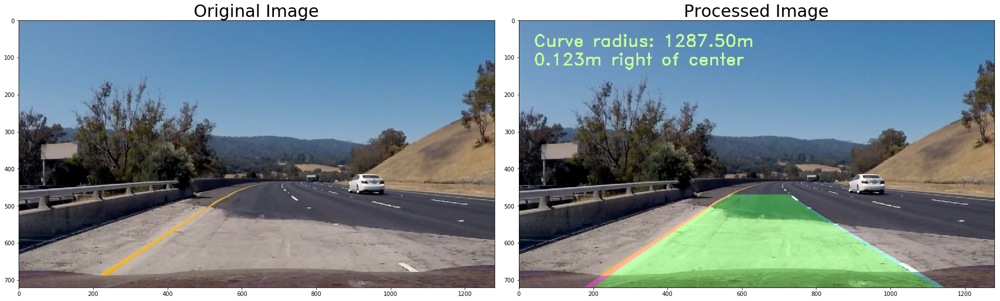

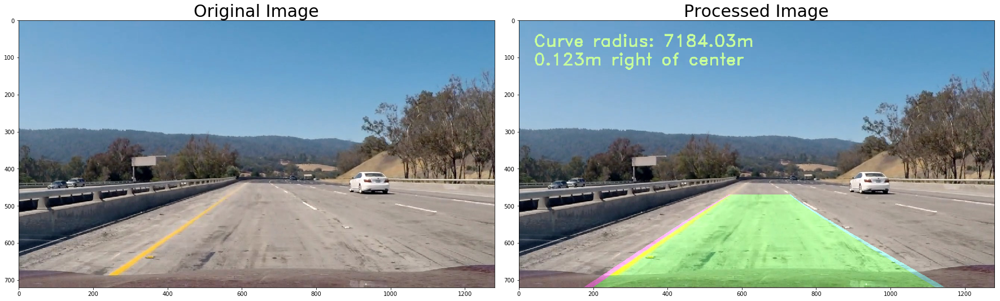

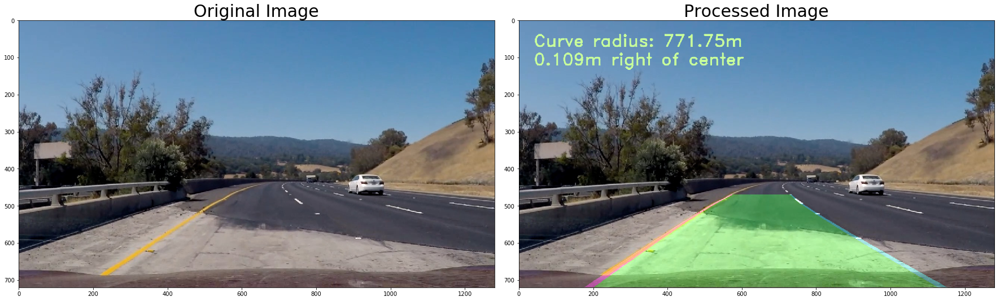

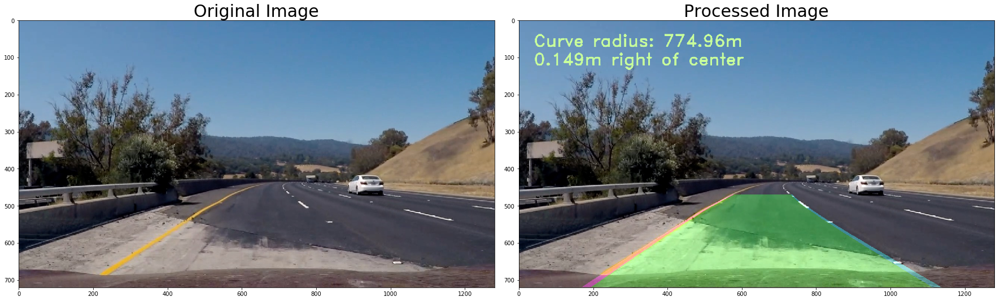

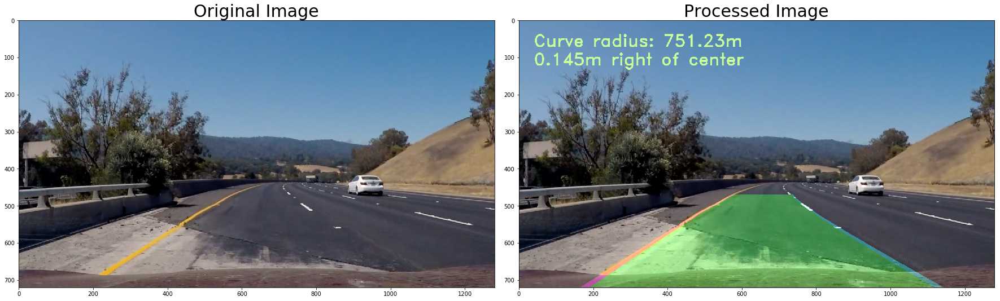

...

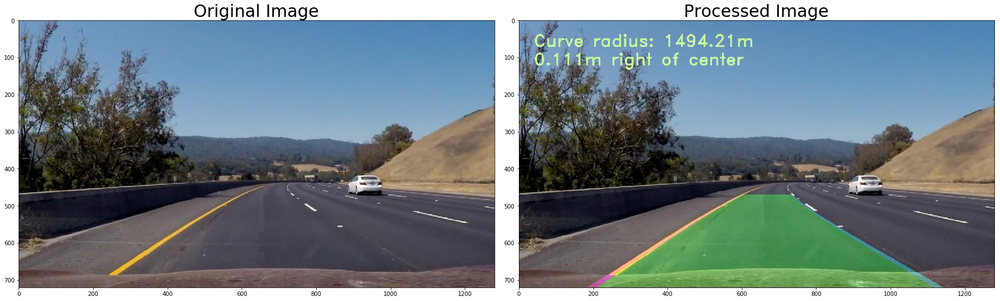

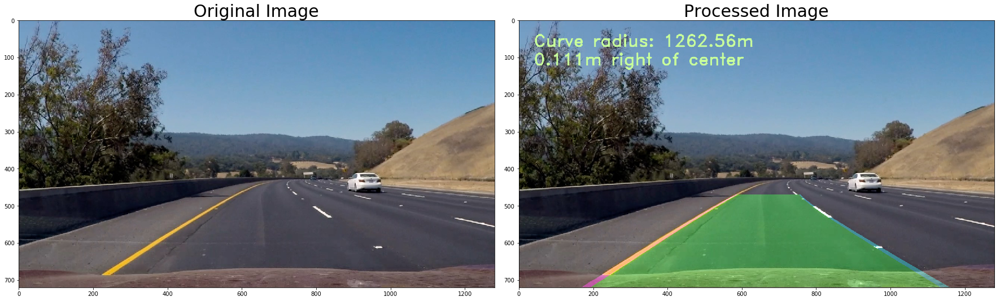

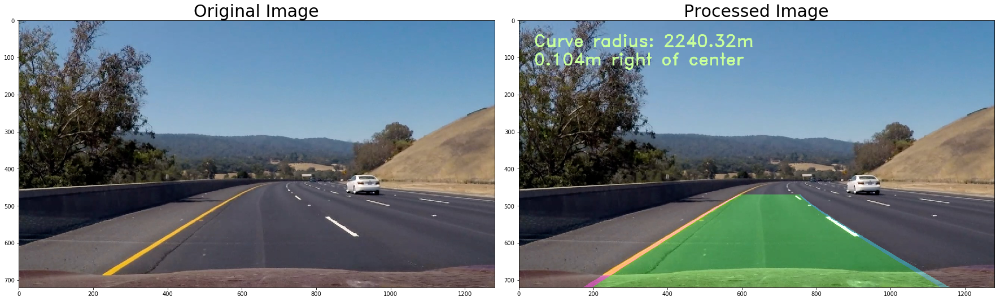

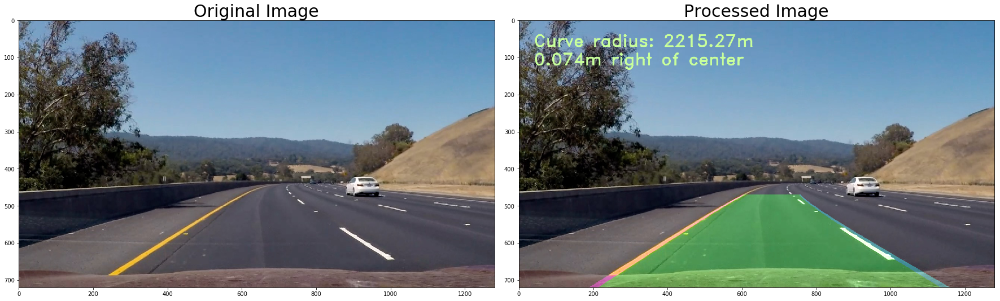

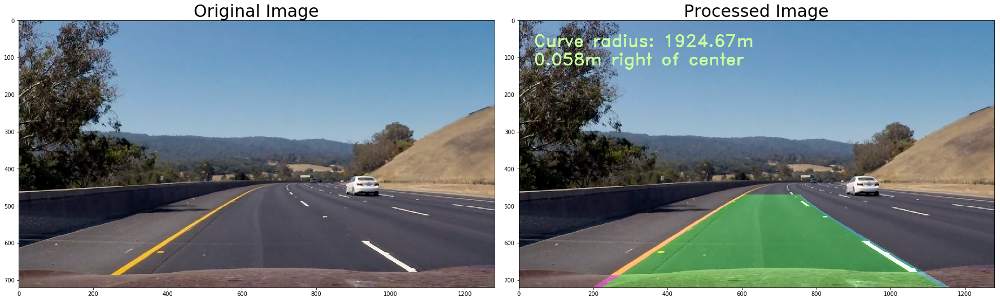

In [55]:
# Test pipeline on "sharp turn" images
#test_images = glob.glob('./test_images/test*.jpg')
#test_images = glob.glob('./trouble_images/newbad[1-9].jpg')
#test_images = glob.glob('./right_turn/right_turn*.jpg')
test_images = glob.glob('./trouble_images/428_1*.jpg')
#test_images = glob.glob('./trouble_images/528_1_*.jpg')
#test_images = glob.glob('./trouble_images/529_0_*.jpg')
#test_images = glob.glob('./trouble_images/realbad1*.jpg')
for fname in test_images:
    #left_line = Line()
    #right_line = Line()
    test_img = cv2.imread(fname)
    out_img = process_img(test_img)
    
    figure, axes = plt.subplots(1,2, figsize=(24, 9))
    figure.tight_layout()

    #axes[0].set_axis_off()
    axes[0].imshow(cv2.cvtColor(test_img, cv2.COLOR_BGR2RGB))
    axes[0].set_title('Original Image', fontsize=30)
    
    axes[1].imshow(cv2.cvtColor(out_img, cv2.COLOR_BGR2RGB))
    axes[1].set_title('Processed Image', fontsize=30)
    
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

In [56]:
# Apply process_img to video

from moviepy.editor import VideoFileClip
from IPython.display import HTML

left_line = Line()
right_line = Line()

print_diag = False

if print_diag:
    left_line.print_diag = True
    right_line.print_diag = True

#video_output1 = './output_images/AdvancedLanesFinding_video_out_10.mp4'
video_output1 = './trouble_images/video_out_0819_1016.mp4'
video_clip1 = VideoFileClip('./short_project_video.mp4')
processed_video = video_clip1.fl_image(process_img)
%time processed_video.write_videofile(video_output1, audio=False)

[MoviePy] >>>> Building video ./trouble_images/video_out_0819_1016.mp4
[MoviePy] Writing video ./trouble_images/video_out_0819_1016.mp4


100%|█████████▉| 815/816 [09:02<00:00,  1.47it/s]


[MoviePy] Done.
[MoviePy] >>>> Video ready: ./trouble_images/video_out_0819_1016.mp4 

CPU times: user 9min 20s, sys: 1min 45s, total: 11min 6s
Wall time: 9min 3s
